In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import numpy as np

In [ ]:
import numpy as np

# Define the initial state of the column with a bidisperse mixture
# Let's represent small particles by 0 and large particles by 1
# Example: [0, 1, 0, 1, 1, 0] - a column with an alternating pattern of small and large particles
column = np.array([0, 1, 0, 1, 1, 0])

def segregate_column(column):
    """
    Segregate the column based on size, using the rules extracted from the paper:
    - Small particles move down (0s move towards the start of the array)
    - Large particles move up (1s move towards the end of the array)
    """
    # Create a copy of the column to prevent modifying the input array directly
    segregated_column = np.copy(column)

    # Perform segregation by repeatedly swapping adjacent particles if they are out of order
    # (small particle below a large particle)
    swapped = True
    while swapped:
        swapped = False
        for i in range(len(segregated_column) - 1):
            if segregated_column[i] < segregated_column[i + 1]:
                # Swap particles
                segregated_column[i], segregated_column[i + 1] = segregated_column[i + 1], segregated_column[i]
                swapped = True

    return segregated_column

# Segregate the column
segregated_column = segregate_column(column)

segregated_column


array([1, 1, 1, 0, 0, 0])

In [ ]:
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML


class BidisperseMaterialSimulationModified:
    def __init__(self, column_length=20):
        np.random.seed(42)  # For reproducibility
        self.column = np.random.randint(2, size=column_length)  # Initial column state
        self.history = [self.column.copy()]  # Track history of segregation

    def segregate_step(self):
        """Perform one step of segregation."""
        swapped = False
        for i in range(len(self.column) - 1):
            if self.column[i] < self.column[i + 1]:
                self.column[i], self.column[i + 1] = self.column[i + 1], self.column[i]
                swapped = True
                break  # Only perform one swap per step to slow down the process
        if swapped:
            self.history.append(self.column.copy())  # Add the state to the history after each step

    def animate(self, steps=50):
        """Animate the segregation process with visible steps."""
        fig, ax = plt.subplots()
        ax.set_title('Bidisperse Material Segregation Simulation - Step by Step')
        ax.set_xlim(-0.5, 0.5)
        ax.set_ylim(0, len(self.column))
        bars = ax.bar(0, bottom=range(len(self.column)), height=0.8, width=0.5, color='grey', edgecolor='black')

        for _ in range(steps):
            self.segregate_step()  # Perform segregation steps

        def init():
            for bar, height in zip(bars, self.history[0]):
                bar.set_color('blue' if height == 1 else 'red')  # Initial state
            return bars

        def update(frame):
            for bar, height in zip(bars, self.history[frame]):
                bar.set_color('blue' if height == 1 else 'red')
            return bars

        anim = FuncAnimation(fig, update, frames=len(self.history), init_func=init, blit=True, repeat=False)
        plt.close()  # Prevent the static plot from displaying
        return anim

# Initialize the simulation with a column of length 20
simulation_modified = BidisperseMaterialSimulationModified(column_length=20)
# Run the simulation and animate the segregation process
anim_modified = simulation_modified.animate(steps=50)  # Adjust the number of steps as needed

# Display the animation
HTML(anim_modified.to_jshtml())



In [ ]:
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import HTML

class BidisperseMaterialSimulationAdvanced:
    def __init__(self, column_length=20, ks=1.0, gamma_dot=1.0):
        np.random.seed(42)  # For reproducibility
        self.column = np.random.randint(2, size=column_length)  # Initial column state
        self.ks = ks  # Segregation rate control parameter
        self.gamma_dot = gamma_dot  # Shear rate
        self.history = [self.column.copy()]  # Track history of segregation

    def calculate_segregation_rate(self, i):
        """Calculate the segregation rate for a given position."""
        if i == 0 or i == len(self.column) - 1:  # Edge cases
            return 0
        si_j = self.column[i]
        si_j_minus = self.column[i - 1]
        si_j_plus = self.column[i + 1]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        f = self.ks * self.gamma_dot * (si_j - avg_size)
        return f

    def segregate_step(self):
        """Perform one step of segregation using the advanced model."""
        for phase in [0, 1]:  # Odd and even phases
            for i in range(phase, len(self.column), 2):
                f = self.calculate_segregation_rate(i)
                if f > 0 and i < len(self.column) - 1 and self.column[i] > self.column[i + 1]:
                    # Swap up
                    self.column[i], self.column[i + 1] = self.column[i + 1], self.column[i]
                elif f < 0 and i > 0 and self.column[i] < self.column[i - 1]:
                    # Swap down
                    self.column[i], self.column[i - 1] = self.column[i - 1], self.column[i]
            self.history.append(self.column.copy())  # Add the state to the history after each phase

    def animate(self, steps=50):
        """Animate the segregation process with visible steps."""
        fig, ax = plt.subplots()
        ax.set_title('Advanced Bidisperse Material Segregation Simulation')
        ax.set_xlim(-0.5, 0.5)
        ax.set_ylim(0, len(self.column))
        bars = ax.bar(0, bottom=range(len(self.column)), height=0.8, width=0.5, color='grey', edgecolor='black')

        for _ in range(steps):
            self.segregate_step()  # Perform segregation steps

        def init():
            for bar, height in zip(bars, self.history[0]):
                bar.set_color('blue' if height == 1 else 'red')  # Initial state
            return bars

        def update(frame):
            for bar, height in zip(bars, self.history[frame]):
                bar.set_color('blue' if height == 1 else 'red')
            return bars

        anim = FuncAnimation(fig, update, frames=len(self.history), init_func=init, blit=True, repeat=False)
        plt.close()  # Prevent the static plot from displaying
        return anim

# Initialize the simulation with a column of length 20
simulation_advanced = BidisperseMaterialSimulationAdvanced(column_length=20)
# Run the simulation and animate the segregation process
anim_advanced = simulation_advanced.animate(steps=10)  # Increase the number of steps to better visualize the process

# Display the animation
HTML(anim_advanced.to_jshtml())


In [ ]:
class BidisperseMaterialSimulationAdvanced:
    def __init__(self, column_length=20, ks=1.0, gamma_dot=1.0):
        np.random.seed(42)  # For reproducibility
        self.column = np.random.randint(2, size=column_length)  # Initial column state
        self.ks = ks  # Segregation rate control parameter
        self.gamma_dot = gamma_dot  # Shear rate
        self.history = [self.column.copy()]  # Track history of segregation

    def calculate_segregation_rate(self, i):
        """Calculate the segregation rate for a given position."""
        if i == 0 or i == len(self.column) - 1:  # Edge cases
            return 0
        si_j = self.column[i]
        si_j_minus = self.column[i - 1]
        si_j_plus = self.column[i + 1]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        f = self.ks * self.gamma_dot * (si_j - avg_size)
        return f

    def segregate_step(self):
        """Perform one step of segregation using the advanced model."""
        for phase in [0, 1]:  # Odd and even phases
            for i in range(phase, len(self.column), 2):
                f = self.calculate_segregation_rate(i)
                if f > 0 and i < len(self.column) - 1 and self.column[i] > self.column[i + 1]:
                    # Swap up
                    self.column[i], self.column[i + 1] = self.column[i + 1], self.column[i]
                elif f < 0 and i > 0 and self.column[i] < self.column[i - 1]:
                    # Swap down
                    self.column[i], self.column[i - 1] = self.column[i - 1], self.column[i]
            self.history.append(self.column.copy())  # Add the state to the history after each phase

    def animate(self, steps=50):
        """Animate the segregation process with visible steps."""
        fig, ax = plt.subplots()
        ax.set_title('Advanced Bidisperse Material Segregation Simulation')
        ax.set_xlim(-0.5, 0.5)
        ax.set_ylim(0, len(self.column))
        bars = ax.bar(0, bottom=range(len(self.column)), height=0.8, width=0.5, color='grey', edgecolor='black')

        for _ in range(steps):
            self.segregate_step()  # Perform segregation steps

        def init():
            for bar, height in zip(bars, self.history[0]):
                bar.set_color('blue' if height == 1 else 'red')  # Initial state
            return bars

        def update(frame):
            for bar, height in zip(bars, self.history[frame]):
                bar.set_color('blue' if height == 1 else 'red')
            return bars

        anim = FuncAnimation(fig, update, frames=len(self.history), init_func=init, blit=True, repeat=False)
        plt.close()  # Prevent the static plot from displaying
        return anim



# Initialize and run your simulation
simulation_advanced = BidisperseMaterialSimulationAdvanced(column_length=20, ks=1.0, gamma_dot=1.0)
# simulation_advanced.run_simulation(steps=50)

# # Plot the static 2D grid of the soil profile over time
# simulation_advanced.plot_static_grid()

# Initialize the simulation with a column of length 20
simulation_advanced = BidisperseMaterialSimulationAdvanced(column_length=400)
# Run the simulation and animate the segregation process
anim_advanced = simulation_advanced.animate(steps=200)  # Increase the number of steps to better visualize the process

# Display the animation
HTML(anim_advanced.to_jshtml())


In [ ]:
simulation_advanced.plot_static_grid()

AttributeError: 'BidisperseMaterialSimulationAdvanced' object has no attribute 'plot_static_grid'

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

class BidisperseMaterialSimulationAdvanced:
    def __init__(self, column_length=20, ks=1.0, gamma_dot=1.0, types=3):
        np.random.seed(42)  # For reproducibility
        self.column = np.random.randint(types, size=column_length)  # Initial column state with more than 2 types
        self.ks = ks  # Segregation rate control parameter
        self.gamma_dot = gamma_dot  # Shear rate
        self.history = [self.column.copy()]  # Track history of segregation

    def calculate_segregation_rate(self, i):
        """Calculate the segregation rate for a given position."""
        if i == 0 or i == len(self.column) - 1:  # Edge cases
            return 0
        si_j = self.column[i]
        si_j_minus = self.column[i - 1]
        si_j_plus = self.column[i + 1]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        f = self.ks * self.gamma_dot * (si_j - avg_size)
        return f

    def segregate_step(self):
        """Perform one step of segregation using the advanced model."""
        for phase in [0, 1]:  # Odd and even phases
            for i in range(phase, len(self.column), 2):
                f = self.calculate_segregation_rate(i)
                if f > 0 and i < len(self.column) - 1 and self.column[i] > self.column[i + 1]:
                    self.column[i], self.column[i + 1] = self.column[i + 1], self.column[i]
                elif f < 0 and i > 0 and self.column[i] < self.column[i - 1]:
                    self.column[i], self.column[i - 1] = self.column[i - 1], self.column[i]
            self.history.append(self.column.copy())  # Add the state to the history after each phase

    def animate(self, steps=50):
        """Animate the segregation process with visible steps."""
        fig, ax = plt.subplots()
        ax.set_title('Advanced Bidisperse Material Segregation Simulation')
        ax.set_xlim(-0.5, 0.5)
        ax.set_ylim(0, len(self.column))
        bars = ax.bar(0, bottom=range(len(self.column)), height=0.8, width=0.5, color='grey', edgecolor='black')

        for _ in range(steps):
            self.segregate_step()  # Perform segregation steps

        def init():
            for bar, height in zip(bars, self.history[0]):
                if height == 0:
                    bar.set_color('red')  # Type 0
                elif height == 1:
                    bar.set_color('blue')  # Type 1
                else:
                    bar.set_color('green')  # Type 2 or more
            return bars

        def update(frame):
            for bar, height in zip(bars, self.history[frame]):
                if height == 0:
                    bar.set_color('red')  # Type 0
                elif height == 1:
                    bar.set_color('blue')  # Type 1
                else:
                    bar.set_color('green')  # Type 2 or more
            return bars

        anim = FuncAnimation(fig, update, frames=len(self.history), init_func=init, blit=True, repeat=False)
        plt.close()  # Prevent the static plot from displaying
        return anim

    def plot_static_grid(self):
        """Plot the static 2D grid of the soil profile over time."""
        plt.figure(figsize=(12, 8))
        plt.imshow(self.history, aspect='auto', cmap='viridis')
        plt.colorbar(label='Particle Type')
        plt.title('Soil Profile Over Time')
        plt.xlabel('Position in Column')
        plt.ylabel('Time Step')
        plt.show()

# Initialize the simulation with a column of length 20 and more than 2 types of particles
simulation_advanced = BidisperseMaterialSimulationAdvanced(column_length=100, types=3)
# Run the simulation and animate the segregation process
anim_advanced = simulation_advanced.animate(steps=50)  # Increase the number of steps to better visualize the process

# Display the animation
HTML(anim_advanced.to_jshtml())


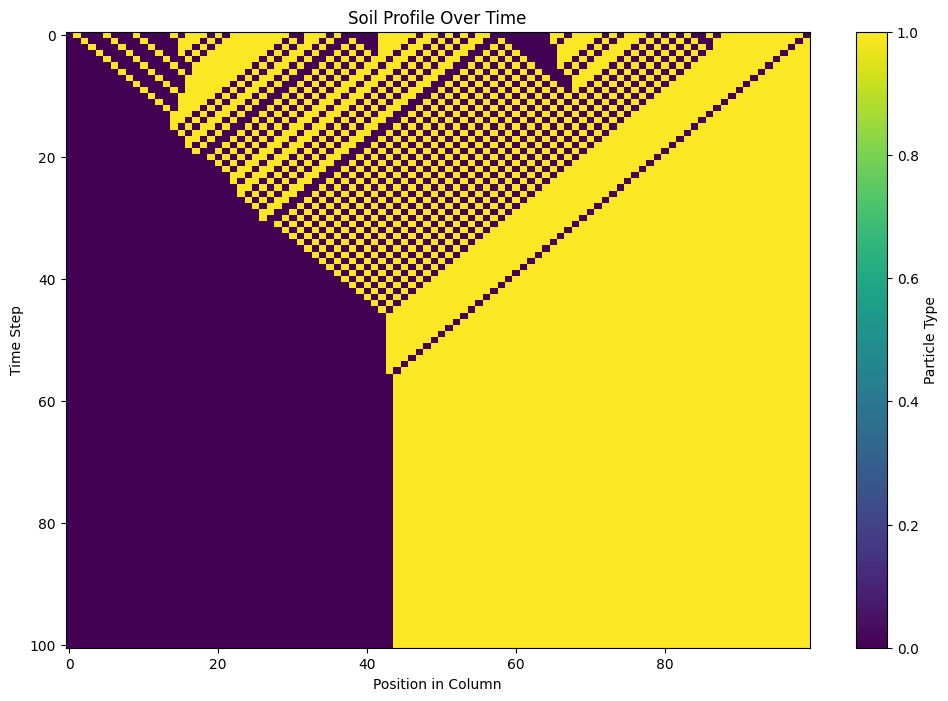

In [ ]:
simulation_advanced.plot_static_grid()

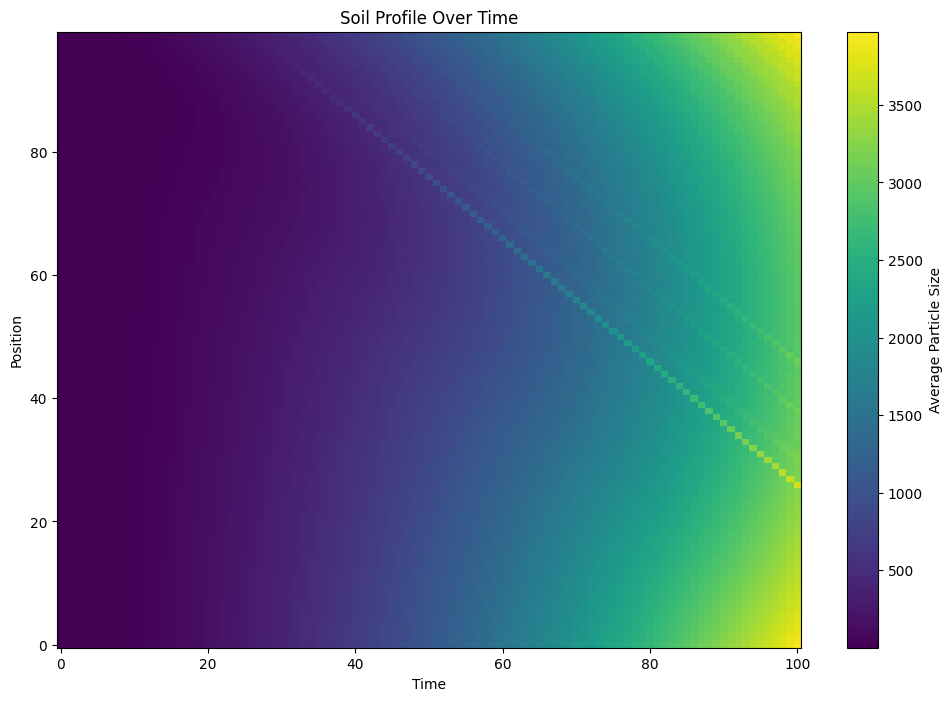

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

class BidisperseMaterialSimulationAdvanced3:
    def __init__(self, column_height=20, column_width=1, ks=1.0, types=2):
        np.random.seed(42)  # For reproducibility
        self.column_height = column_height
        self.column_width = column_width
        self.ks = ks  # Segregation rate control parameter
        self.column = np.random.choice(types, size=(column_height, column_width), p=[0.5, 0.5])
        self.history = [self.column.copy()]

    def calculate_segregation_rate(self, i, j):
        if i == 0 or i == self.column_height - 1:  # Edge cases
            return 0
        si_j = self.column[i][j]
        si_j_minus = self.column[i - 1][j]
        si_j_plus = self.column[i + 1][j]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        return self.ks * (si_j - avg_size)

    def apply_shear(self, step):
        for i in range(self.column_height):
            for j in range(self.column_width):
                z = i / self.column_height
                gamma_dot = np.sqrt(1 - z) if i > 0 else 1  # Simple shear for top layer, inclined plane for others
                self.column[i][j] += gamma_dot * step

    def segregate_step(self):
        for i in range(self.column_height):
            for j in range(self.column_width):
                f = self.calculate_segregation_rate(i, j)
                if f > 0 and i < self.column_height - 1:
                    self.column[i][j], self.column[i + 1][j] = self.column[i + 1][j], self.column[i][j]
                elif f < 0 and i > 0:
                    self.column[i][j], self.column[i - 1][j] = self.column[i - 1][j], self.column[i][j]
        self.history.append(self.column.copy())

    def run_simulation(self, steps=50):
        for step in range(steps):
            self.apply_shear(step)
            self.segregate_step()

    def average_in_m_direction(self):
        return [np.mean(state, axis=1) for state in self.history]

    def plot_static_grid(self):
        averaged_history = self.average_in_m_direction()
        plt.figure(figsize=(12, 8))
        data_to_plot = np.array(averaged_history).T
        plt.imshow(data_to_plot, aspect='auto', cmap='viridis', origin='lower')
        plt.colorbar(label='Average Particle Size')
        plt.title('Soil Profile Over Time')
        plt.xlabel('Time')
        plt.ylabel('Position')
        plt.show()

# Example usage:
M = 20
simulation_advanced = BidisperseMaterialSimulationAdvanced3(column_height=100, column_width=M)
simulation_advanced.run_simulation(steps=100)
simulation_advanced.plot_static_grid()


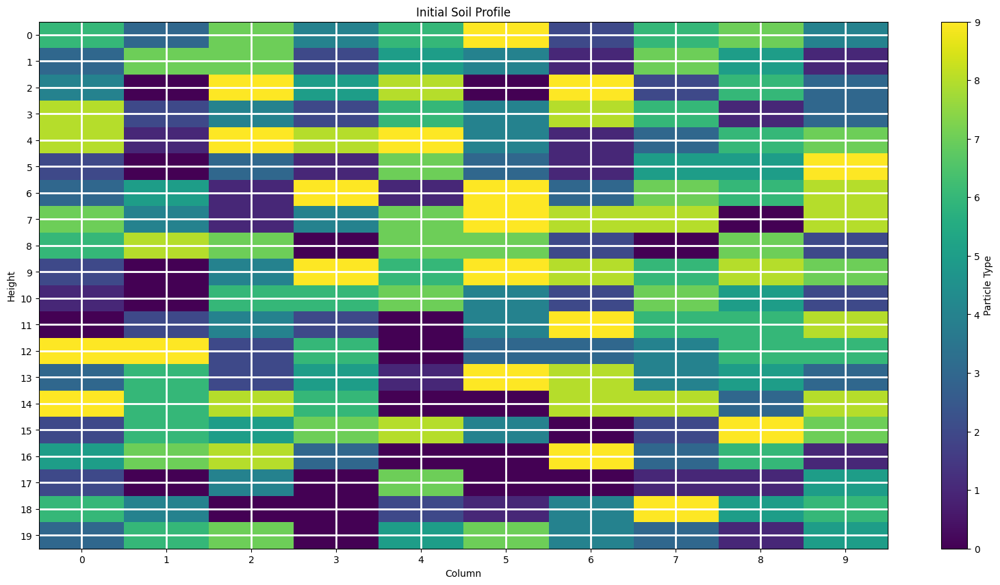

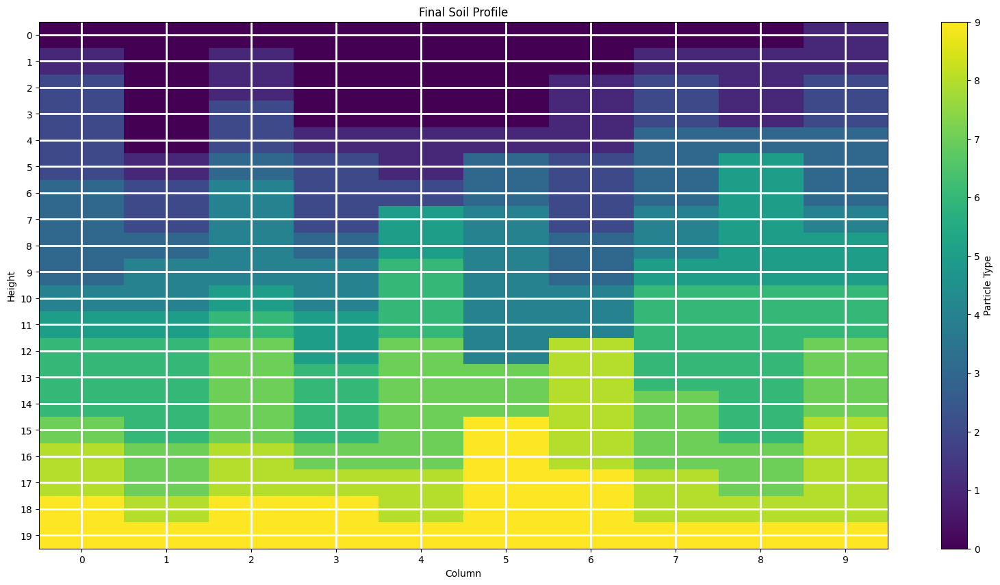

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter

class BidisperseMaterialSimulationAdvanced2D:
    def __init__(self, column_height=20, column_width=10, ks=1.0, gamma_dot=1.0, types=3):
        np.random.seed(42)  # For reproducibility
        self.grid = np.random.randint(types, size=(column_height, column_width)).astype(float)
        self.ks = ks  # Segregation rate control parameter
        self.gamma_dot = gamma_dot  # Shear rate
        self.history = [self.grid.copy()]  # Track history of segregation

    def calculate_segregation_rate(self, col, i):
        if i == 0 or i == len(self.grid[:, col]) - 1:  # Edge cases
            return 0
        si_j = self.grid[i, col]
        si_j_minus = self.grid[i - 1, col]
        si_j_plus = self.grid[i + 1, col]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        f = self.ks * self.gamma_dot * (si_j - avg_size)
        return f

    def segregate_step(self):
        for col in range(self.grid.shape[1]):
            for phase in [0, 1]:
                for i in range(phase, len(self.grid[:, col]), 2):
                    f = self.calculate_segregation_rate(col, i)
                    if f > 0 and i < len(self.grid[:, col]) - 1 and self.grid[i, col] > self.grid[i + 1, col]:
                        self.grid[i, col], self.grid[i + 1, col] = self.grid[i + 1, col], self.grid[i, col]
                    elif f < 0 and i > 0 and self.grid[i, col] < self.grid[i - 1, col]:
                        self.grid[i, col], self.grid[i - 1, col] = self.grid[i - 1, col], self.grid[i, col]
        self.history.append(self.grid.copy())

    def run_simulation(self, steps=50):
        for _ in range(steps):
            self.segregate_step()

    def animate(self):
        fig, ax = plt.subplots()
        ax.set_title('Advanced Bidisperse Material Segregation Simulation 2D')
        ax.set_xlabel('Column')
        ax.set_ylabel('Height')
        im = ax.imshow(self.history[0], cmap='viridis', animated=True)

        def update(frame):
            im.set_array(self.history[frame])
            return [im]

        anim = FuncAnimation(fig, update, frames=len(self.history), blit=True, repeat=False)
        plt.close()  # Prevent the static plot from displaying
        return anim

    def plot_grid(self, data, title):
        plt.figure(figsize=(20, 10))
        plt.imshow(data, aspect='auto', cmap='viridis')
        plt.colorbar(label='Particle Type')
        plt.title(title)
        plt.xlabel('Column')
        plt.ylabel('Height')
        plt.xticks(np.arange(data.shape[1]))  # Set x-ticks for each column
        plt.yticks(np.arange(data.shape[0]))  # Set y-ticks for each row
        plt.grid(True, which='both', linestyle='-', color='w', linewidth=2)
        plt.show()

# Example usage
simulation_advanced = BidisperseMaterialSimulationAdvanced2D(column_height=20, column_width=10, types=10)
# Plot initial grid
simulation_advanced.plot_grid(simulation_advanced.grid, 'Initial Soil Profile')
# Run the simulation
simulation_advanced.run_simulation(steps=50)
# Generate the animation
anim_advanced = simulation_advanced.animate()
anim_advanced.save('segregation.gif', writer=PillowWriter(fps=10))
# Plot the final grid
simulation_advanced.plot_grid(simulation_advanced.history[-1], 'Final Soil Profile')


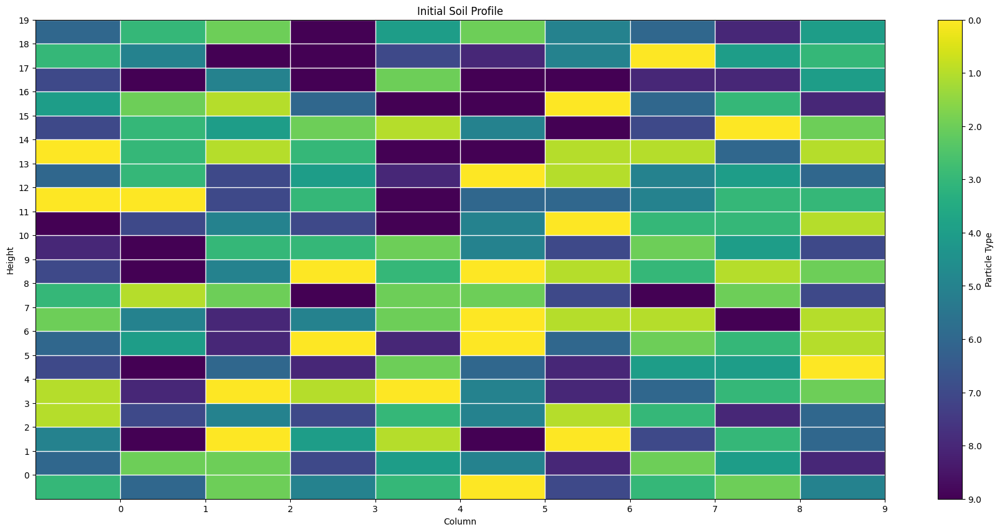

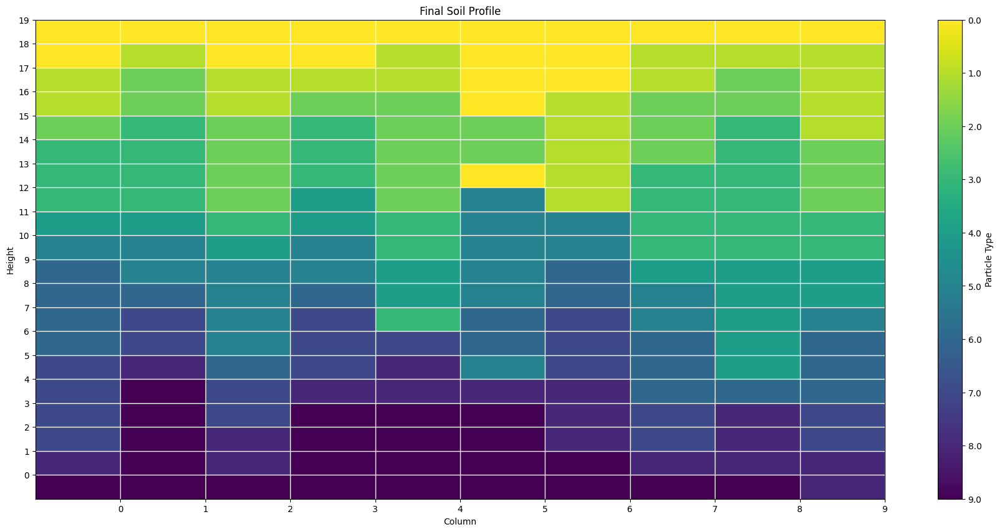

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter

class BidisperseMaterialSimulationAdvanced2D:
    def __init__(self, column_height=20, column_width=10, ks=1.0, gamma_dot=1.0, types=3):
        np.random.seed(42)
        self.grid = np.random.randint(types, size=(column_height, column_width)).astype(float)
        self.ks = ks
        self.gamma_dot = gamma_dot
        self.history = [self.grid.copy()]

    def calculate_segregation_rate(self, col, i):
        if i == 0 or i == len(self.grid[:, col]) - 1:
            return 0
        si_j = self.grid[i, col]
        si_j_minus = self.grid[i - 1, col]
        si_j_plus = self.grid[i + 1, col]
        avg_size = (si_j_minus + si_j_plus) / 2.0
        return self.ks * self.gamma_dot * (avg_size - si_j)  # Inverse logic for heavier sinking

    def segregate_step(self):
        for col in range(self.grid.shape[1]):
            for phase in [0, 1]:
                for i in range(phase, len(self.grid[:, col]), 2):
                    f = self.calculate_segregation_rate(col, i)
                    if f > 0 and i > 0:  # Move up if lighter
                        self.grid[i, col], self.grid[i - 1, col] = self.grid[i - 1, col], self.grid[i, col]
                    elif f < 0 and i < len(self.grid[:, col]) - 1:  # Move down if heavier
                        self.grid[i, col], self.grid[i + 1, col] = self.grid[i + 1, col], self.grid[i, col]
        self.history.append(self.grid.copy())

    def run_simulation(self, steps=50):
        for _ in range(steps):
            self.segregate_step()

    def plot_grid(self, data, title):
        plt.figure(figsize=(22, 10))
        im = plt.imshow(data, aspect='auto', cmap='viridis', origin='lower')
        cbar = plt.colorbar(im, label='Particle Type')

        # Invert the colorbar by setting ticks and labels manually
        types = int(np.max(data))  # Assumes types are integer values from 0 to max
        tick_values = np.linspace(0, types, num=types+1)  # Create an array from 0 to max types
        tick_labels = list(reversed(tick_values))  # Reverse the array for descending order labels
        cbar.set_ticks(tick_values)  # Set tick positions
        cbar.set_ticklabels(tick_labels)

        plt.title(title)
        plt.xlabel('Column')
        plt.ylabel('Height')
        plt.xticks(np.arange(0.5, data.shape[1], 1), np.arange(data.shape[1]))
        plt.yticks(np.arange(0.5, data.shape[0], 1), np.arange(data.shape[0]))
        plt.grid(True, linestyle='-', color='w', linewidth=1, which='both')
        plt.show()

    def animate(self):
        fig, ax = plt.subplots()
        ax.set_title('Advanced Bidisperse Material Segregation Simulation 2D')
        im = ax.imshow(self.history[0], cmap='viridis', animated=True, origin='lower')
        def update(frame):
            im.set_array(self.history[frame])
            return [im]
        anim = FuncAnimation(fig, update, frames=len(self.history), blit=True, repeat=False)
        plt.close()
        return anim

# Example usage
simulation_advanced = BidisperseMaterialSimulationAdvanced2D(column_height=20, column_width=10, types=10)
simulation_advanced.plot_grid(simulation_advanced.grid, 'Initial Soil Profile')
simulation_advanced.run_simulation(steps=50)
anim_advanced = simulation_advanced.animate()
anim_advanced.save('segregation.gif', writer=PillowWriter(fps=10))
simulation_advanced.plot_grid(simulation_advanced.history[-1], 'Final Soil Profile')


<ipython-input-16-4817fec43a11>:31: RuntimeWarning: invalid value encountered in sqrt
  gamma_dot = np.sqrt((1 - z) / s)


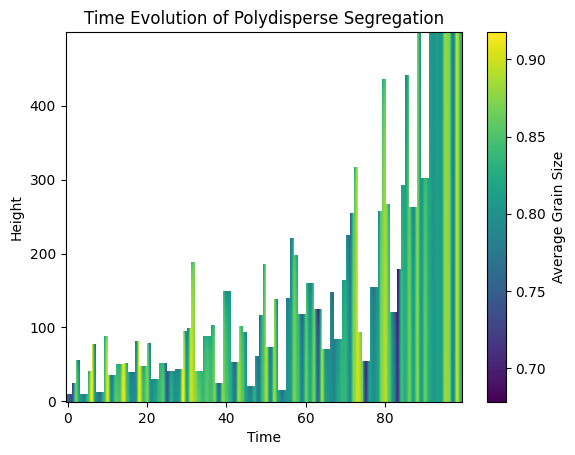

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel1:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        # Ensure segregation_rate is a numpy array to enable element-wise operations
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        # Initialize column with a range of particle sizes based on Eq. 16
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
        for i in range(self.column_height):
            for j in range(self.num_cells_m):
                z = i / self.column_height
                s = self.column[i][j]
                gamma_dot = np.sqrt((1 - z) / s)
                local_average_size = np.mean(self.column[i, :])
                # Use the segregative velocity for each height
                segregative_velocity = self.segregation_rate[i] * gamma_dot * (s / local_average_size - 1)
                self.column[i, j] += segregative_velocity * self.time_step

    def plot_history(self):
        average_grain_size_history = [np.mean(state, axis=1) for state in self.history]
        plt.imshow(average_grain_size_history, aspect='auto', origin='lower', cmap='viridis')
        plt.colorbar(label='Average Grain Size')
        plt.xlabel('Time')
        plt.ylabel('Height')
        plt.title('Time Evolution of Polydisperse Segregation')
        plt.show()

# Example usage of the model
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time

# Initialize the model with non-uniform segregation rate
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]

model = PolydisperseSegregationModel1(column_height, num_cells_m, segregation_rate, alpha_i, time_step)

# Run the simulation
model.run_simulation(total_time)

# Plot the results
model.plot_history()


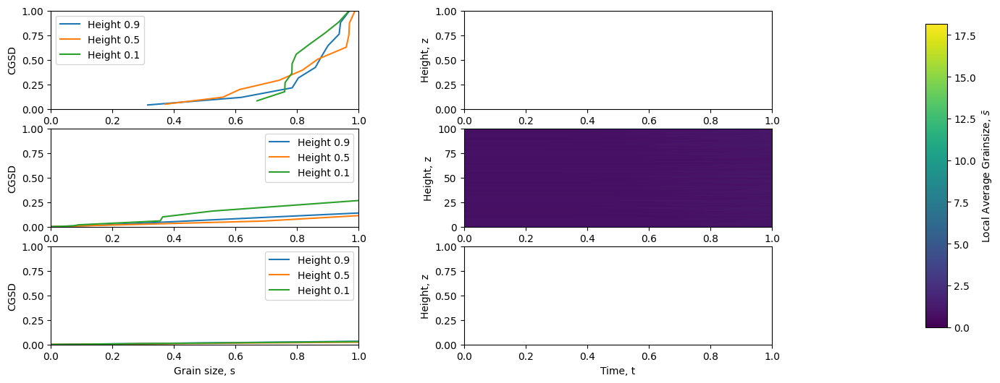

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase

class PolydisperseSegregationModel3:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
        ks = 1  # Constant segregation rate
        gamma_dot = 1  # Constant shear rate

        for i in range(self.column_height):
            local_average_size = np.mean(self.column[i, :])  # Average grainsize at height i

            for j in range(self.num_cells_m):
                s = self.column[i, j]  # Grainsize of the cell
                segregative_velocity = ks * gamma_dot * (s - local_average_size)
                updated_s = s + segregative_velocity * self.time_step
                self.column[i, j] = max(updated_s, 0)  # Prevent negative grain sizes

    def calculate_local_average_grainsize(self):
        # Calculate the local average grainsize over the nearest two neighbours in the m-direction
        local_avg_grainsize = np.zeros_like(self.column)
        # Apply periodic boundary conditions in the m-direction
        extended_column = np.column_stack((self.column[:, -1], self.column, self.column[:, 0]))
        for i in range(self.column_height):
            for j in range(1, self.num_cells_m + 1):  # Adjusted indices for the extended column
                local_avg_grainsize[i, j - 1] = (extended_column[i, j - 1] + extended_column[i, j + 1]) / 2
        return local_avg_grainsize

    def plot_results(self):
      fig, axs = plt.subplots(3, 3, figsize=(15, 6), gridspec_kw={'width_ratios': [1, 1, 0.05]})
      fig.subplots_adjust(wspace=0.5)

      # Determine the local average grainsize and its normalized values for color mapping
      local_avg_grainsize = self.calculate_local_average_grainsize()
      norm = Normalize(vmin=local_avg_grainsize.min(), vmax=local_avg_grainsize.max())

      # Iterate through the time snapshots to plot the graphs
      for i, time_idx in enumerate([0, len(self.history)//2, -1]):
          grainsize_distribution = np.sort(self.history[time_idx], axis=1)
          cumulative_distribution = np.cumsum(grainsize_distribution, axis=1)
          cumulative_distribution /= np.max(cumulative_distribution, axis=1)[:, np.newaxis]

          # Plot cumulative grainsize distribution for selected heights
          for height_fraction in [0.9, 0.5, 0.1]:
              height_index = int(height_fraction * self.column_height)
              axs[i, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
              axs[i, 0].legend()
              axs[i, 0].set_xlabel('Grain size, s')
              axs[i, 0].set_ylabel('CGSD')
              axs[i, 0].set_xlim([0, 1])
              axs[i, 0].set_ylim([0, 1])

          # Plot the heatmap of average grainsize over time
          if time_idx > 0:
              avg_grainsize_over_time = [np.mean(timestep, axis=1) for timestep in self.history[:time_idx + 1]]
              avg_grainsize_over_time = np.array(avg_grainsize_over_time).T  # Transpose to match the axes
              im = axs[i, 1].imshow(avg_grainsize_over_time, aspect='auto', origin='lower', cmap='viridis', norm=norm,
                                     extent=[0, self.history[time_idx].shape[0] * self.time_step, 0, self.column_height])
          axs[i, 1].set_xlabel('Time, t')
          axs[i, 1].set_ylabel('Height, z')

      # Remove empty subplots by clearing them
      for ax in axs[:, 2]:
          ax.remove()
      axs = np.delete(axs, 2, 1)  # Remove the third column from the array to prevent index errors

      # Create the color bar for the local average grainsize
      cbar_ax = fig.add_axes([0.93, 0.15, 0.02, 0.7])
      cbar = fig.colorbar(im, cax=cbar_ax)
      cbar.set_label('Local Average Grainsize, $\\bar{s}$')

      plt.show()


# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel3(column_height, num_cells_m, 1, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()


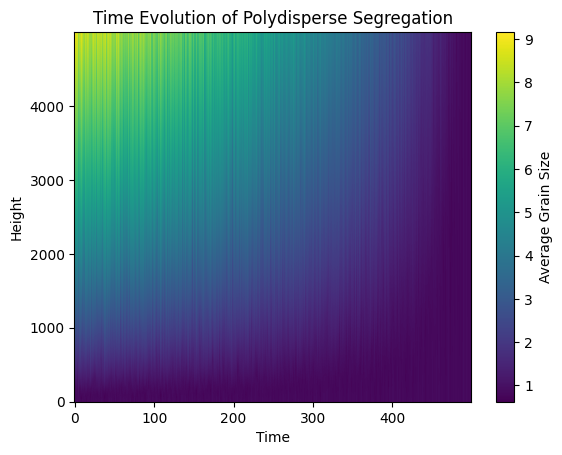

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel4:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        # Ensure segregation_rate is a numpy array to enable element-wise operations
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        # Initialize column with a range of particle sizes based on Eq. 16
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
      for i in range(self.column_height):
          for j in range(self.num_cells_m):
              z = i / self.column_height
              s = self.column[i][j]
              if s <= 0:
                  continue  # Skip the computation if s is zero or negative
              gamma_dot = np.sqrt(max(0, (1 - z) / max(s, 1e-6)))  # Adding a small epsilon to s to avoid division by zero
              local_average_size = np.mean(self.column[i, :])
              segregative_velocity = self.segregation_rate[i] * gamma_dot * (s / local_average_size - 1)
              self.column[i, j] += segregative_velocity * self.time_step

    def plot_history(self):
        average_grain_size_history = [np.mean(state, axis=1) for state in self.history]
        plt.imshow(average_grain_size_history, aspect='auto', origin='lower', cmap='viridis')
        plt.colorbar(label='Average Grain Size')
        plt.xlabel('Time')
        plt.ylabel('Height')
        plt.title('Time Evolution of Polydisperse Segregation')
        plt.show()

# Example usage of the model
column_height = 500  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 50       # Total simulation time

# Initialize the model with non-uniform segregation rate
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]

model = PolydisperseSegregationModel4(column_height, num_cells_m, segregation_rate, alpha_i, time_step)

# Run the simulation
model.run_simulation(total_time)

# Plot the results
model.plot_history()

<ipython-input-18-e3eaea9758b6>:31: RuntimeWarning: invalid value encountered in sqrt
  gamma_dot = np.sqrt(shear_factor)


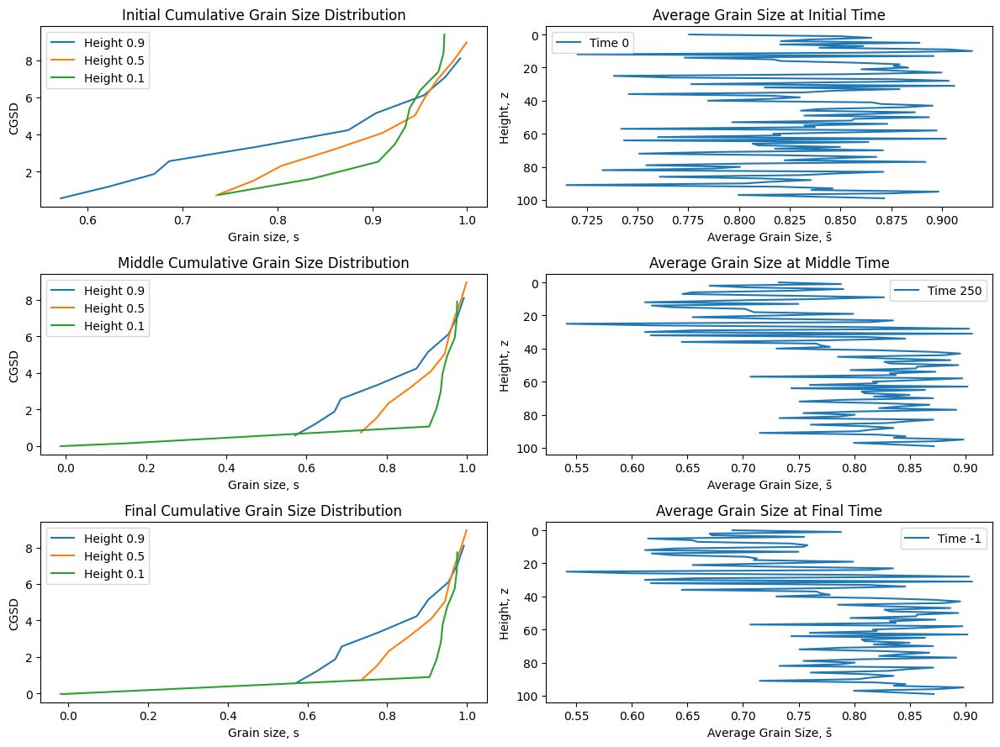

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
      for i in range(self.column_height):
        for j in range(self.num_cells_m):
            z = i / self.column_height
            s = self.column[i, j]
            # Ensure that (1 - z) / s is always non-negative
            shear_factor = (1 - z) / s if s <= (1 - z) else 0
            gamma_dot = np.sqrt(shear_factor)
            local_average_size = np.mean(self.column[i, :])
            segregative_velocity = self.segregation_rate[i] * gamma_dot * (s - local_average_size)
            # Check for NaN values and avoid updating if encountered
            if not np.isnan(segregative_velocity):
                self.column[i, j] += segregative_velocity * self.time_step

    def plot_results(self):
    # Function to plot the final graphs similar to Figure 14 in the paper

    # Plot the cumulative grainsize distributions at different heights
      fig, axs = plt.subplots(3, 2, figsize=(12, 9))  # This creates a 3x2 grid of subplots
      time_snapshots = [0, len(self.history)//2, -1]  # Three time points: start, middle, and end

      for idx, time_point in enumerate(time_snapshots):
        # For the left column: Initial, Middle, and Final cumulative grainsize distributions
        grainsize_distribution = np.sort(self.history[time_point], axis=1)
        cumulative_distribution = np.cumsum(grainsize_distribution, axis=1) / grainsize_distribution[:, -1][:, np.newaxis]

        for height_fraction in [0.9, 0.5, 0.1]:
            height_index = int(height_fraction * self.column_height)
            axs[idx, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
            axs[idx, 0].legend()

        axs[idx, 0].set_xlabel('Grain size, s')
        axs[idx, 0].set_ylabel('CGSD')

        # For the right column: Average grainsize over height at three time snapshots
        average_grainsize = np.mean(self.history[time_point], axis=1)
        axs[idx, 1].plot(average_grainsize, np.arange(self.column_height), label=f'Time {time_point}')
        axs[idx, 1].invert_yaxis()  # Invert y-axis to have 0 at the bottom
        axs[idx, 1].legend()

        axs[idx, 1].set_xlabel('Average Grain Size, s̄')
        axs[idx, 1].set_ylabel('Height, z')

      axs[0, 0].set_title("Initial Cumulative Grain Size Distribution")
      axs[0, 1].set_title(f'Average Grain Size at Initial Time')
      axs[1, 0].set_title("Middle Cumulative Grain Size Distribution")
      axs[1, 1].set_title(f'Average Grain Size at Middle Time')
      axs[2, 0].set_title("Final Cumulative Grain Size Distribution")
      axs[2, 1].set_title(f'Average Grain Size at Final Time')

      plt.tight_layout()
      plt.show()



# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel(column_height, num_cells_m, segregation_rate, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()

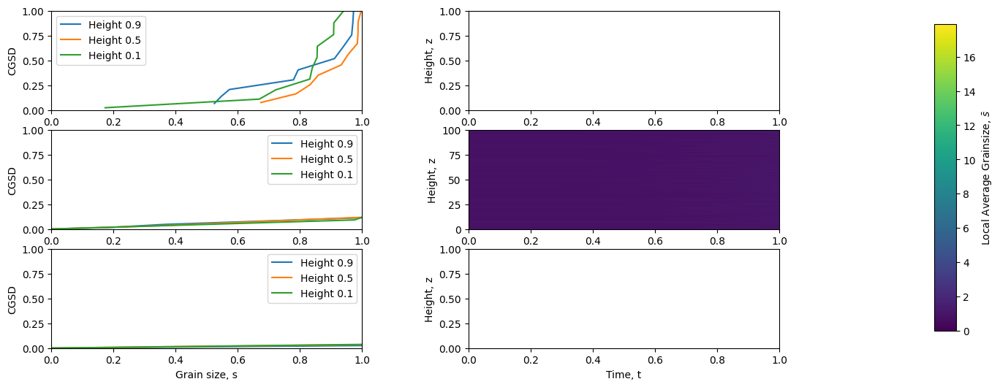

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase

class PolydisperseSegregationModel2:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
        ks = 1  # Constant segregation rate
        gamma_dot = 1  # Constant shear rate

        for i in range(self.column_height):
            local_average_size = np.mean(self.column[i, :])  # Average grainsize at height i

            for j in range(self.num_cells_m):
                s = self.column[i, j]  # Grainsize of the cell
                segregative_velocity = ks * gamma_dot * (s - local_average_size)
                updated_s = s + segregative_velocity * self.time_step
                self.column[i, j] = max(updated_s, 0)  # Prevent negative grain sizes

    def calculate_local_average_grainsize(self):
        # Calculate the local average grainsize over the nearest two neighbours in the m-direction
        local_avg_grainsize = np.zeros_like(self.column)
        # Apply periodic boundary conditions in the m-direction
        extended_column = np.column_stack((self.column[:, -1], self.column, self.column[:, 0]))
        for i in range(self.column_height):
            for j in range(1, self.num_cells_m + 1):  # Adjusted indices for the extended column
                local_avg_grainsize[i, j - 1] = (extended_column[i, j - 1] + extended_column[i, j + 1]) / 2
        return local_avg_grainsize

    def plot_results(self):
      fig, axs = plt.subplots(3, 3, figsize=(15, 6), gridspec_kw={'width_ratios': [1, 1, 0.05]})
      fig.subplots_adjust(wspace=0.5)

      # Determine the local average grainsize and its normalized values for color mapping
      local_avg_grainsize = self.calculate_local_average_grainsize()
      norm = Normalize(vmin=local_avg_grainsize.min(), vmax=local_avg_grainsize.max())

      # Iterate through the time snapshots to plot the graphs
      for i, time_idx in enumerate([0, len(self.history)//2, -1]):
          grainsize_distribution = np.sort(self.history[time_idx], axis=1)
          cumulative_distribution = np.cumsum(grainsize_distribution, axis=1)
          cumulative_distribution /= np.max(cumulative_distribution, axis=1)[:, np.newaxis]

          # Plot cumulative grainsize distribution for selected heights
          for height_fraction in [0.9, 0.5, 0.1]:
              height_index = int(height_fraction * self.column_height)
              axs[i, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
              axs[i, 0].legend()
              axs[i, 0].set_xlabel('Grain size, s')
              axs[i, 0].set_ylabel('CGSD')
              axs[i, 0].set_xlim([0, 1])
              axs[i, 0].set_ylim([0, 1])

          # Plot the heatmap of average grainsize over time
          if time_idx > 0:
              avg_grainsize_over_time = [np.mean(timestep, axis=1) for timestep in self.history[:time_idx + 1]]
              avg_grainsize_over_time = np.array(avg_grainsize_over_time).T  # Transpose to match the axes
              im = axs[i, 1].imshow(avg_grainsize_over_time, aspect='auto', origin='lower', cmap='viridis', norm=norm,
                                     extent=[0, self.history[time_idx].shape[0] * self.time_step, 0, self.column_height])
          axs[i, 1].set_xlabel('Time, t')
          axs[i, 1].set_ylabel('Height, z')

      # Remove empty subplots by clearing them
      for ax in axs[:, 2]:
          ax.remove()
      axs = np.delete(axs, 2, 1)  # Remove the third column from the array to prevent index errors

      # Create the color bar for the local average grainsize
      cbar_ax = fig.add_axes([0.93, 0.15, 0.02, 0.7])
      cbar = fig.colorbar(im, cax=cbar_ax)
      cbar.set_label('Local Average Grainsize, $\\bar{s}$')

      plt.show()


# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel2(column_height, num_cells_m, 1, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()

<ipython-input-21-e3eaea9758b6>:31: RuntimeWarning: invalid value encountered in sqrt
  gamma_dot = np.sqrt(shear_factor)


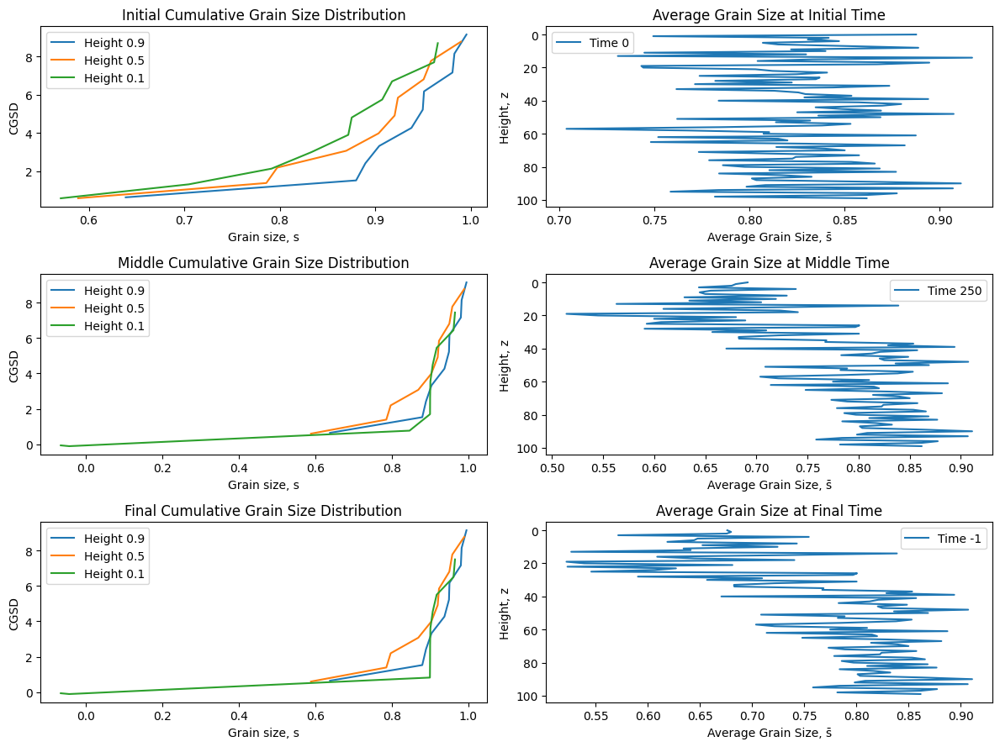

In [ ]:

import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
      for i in range(self.column_height):
        for j in range(self.num_cells_m):
            z = i / self.column_height
            s = self.column[i, j]
            # Ensure that (1 - z) / s is always non-negative
            shear_factor = (1 - z) / s if s <= (1 - z) else 0
            gamma_dot = np.sqrt(shear_factor)
            local_average_size = np.mean(self.column[i, :])
            segregative_velocity = self.segregation_rate[i] * gamma_dot * (s - local_average_size)
            # Check for NaN values and avoid updating if encountered
            if not np.isnan(segregative_velocity):
                self.column[i, j] += segregative_velocity * self.time_step

    def plot_results(self):
    # Function to plot the final graphs similar to Figure 14 in the paper

    # Plot the cumulative grainsize distributions at different heights
      fig, axs = plt.subplots(3, 2, figsize=(12, 9))  # This creates a 3x2 grid of subplots
      time_snapshots = [0, len(self.history)//2, -1]  # Three time points: start, middle, and end

      for idx, time_point in enumerate(time_snapshots):
        # For the left column: Initial, Middle, and Final cumulative grainsize distributions
        grainsize_distribution = np.sort(self.history[time_point], axis=1)
        cumulative_distribution = np.cumsum(grainsize_distribution, axis=1) / grainsize_distribution[:, -1][:, np.newaxis]

        for height_fraction in [0.9, 0.5, 0.1]:
            height_index = int(height_fraction * self.column_height)
            axs[idx, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
            axs[idx, 0].legend()

        axs[idx, 0].set_xlabel('Grain size, s')
        axs[idx, 0].set_ylabel('CGSD')

        # For the right column: Average grainsize over height at three time snapshots
        average_grainsize = np.mean(self.history[time_point], axis=1)
        axs[idx, 1].plot(average_grainsize, np.arange(self.column_height), label=f'Time {time_point}')
        axs[idx, 1].invert_yaxis()  # Invert y-axis to have 0 at the bottom
        axs[idx, 1].legend()

        axs[idx, 1].set_xlabel('Average Grain Size, s̄')
        axs[idx, 1].set_ylabel('Height, z')

      axs[0, 0].set_title("Initial Cumulative Grain Size Distribution")
      axs[0, 1].set_title(f'Average Grain Size at Initial Time')
      axs[1, 0].set_title("Middle Cumulative Grain Size Distribution")
      axs[1, 1].set_title(f'Average Grain Size at Middle Time')
      axs[2, 0].set_title("Final Cumulative Grain Size Distribution")
      axs[2, 1].set_title(f'Average Grain Size at Final Time')

      plt.tight_layout()
      plt.show()



# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel(column_height, num_cells_m, segregation_rate, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()

<ipython-input-22-819a7d3f14e7>:31: RuntimeWarning: invalid value encountered in sqrt
  gamma_dot = np.sqrt((1 - z) / s)


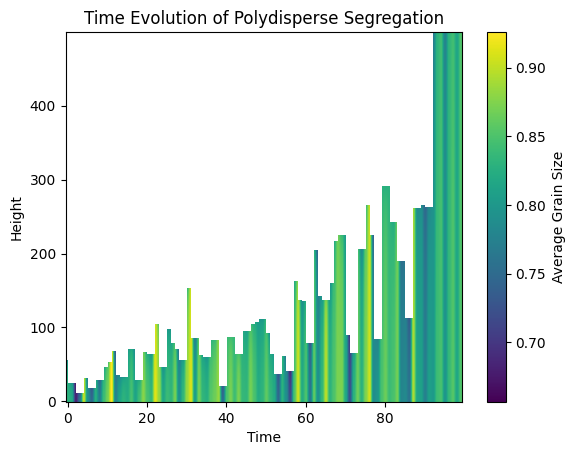

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        # Ensure segregation_rate is a numpy array to enable element-wise operations
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        # Initialize column with a range of particle sizes based on Eq. 16
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
        for i in range(self.column_height):
            for j in range(self.num_cells_m):
                z = i / self.column_height
                s = self.column[i][j]
                gamma_dot = np.sqrt((1 - z) / s)
                local_average_size = np.mean(self.column[i, :])
                # Use the segregative velocity for each height
                segregative_velocity = self.segregation_rate[i] * gamma_dot * (s / local_average_size - 1)
                self.column[i, j] += segregative_velocity * self.time_step

    def plot_history(self):
        average_grain_size_history = [np.mean(state, axis=1) for state in self.history]
        plt.imshow(average_grain_size_history, aspect='auto', origin='lower', cmap='viridis')
        plt.colorbar(label='Average Grain Size')
        plt.xlabel('Time')
        plt.ylabel('Height')
        plt.title('Time Evolution of Polydisperse Segregation')
        plt.show()

# Example usage of the model
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time

# Initialize the model with non-uniform segregation rate
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]

model = PolydisperseSegregationModel(column_height, num_cells_m, segregation_rate, alpha_i, time_step)

# Run the simulation
model.run_simulation(total_time)

# Plot the results
model.plot_history()


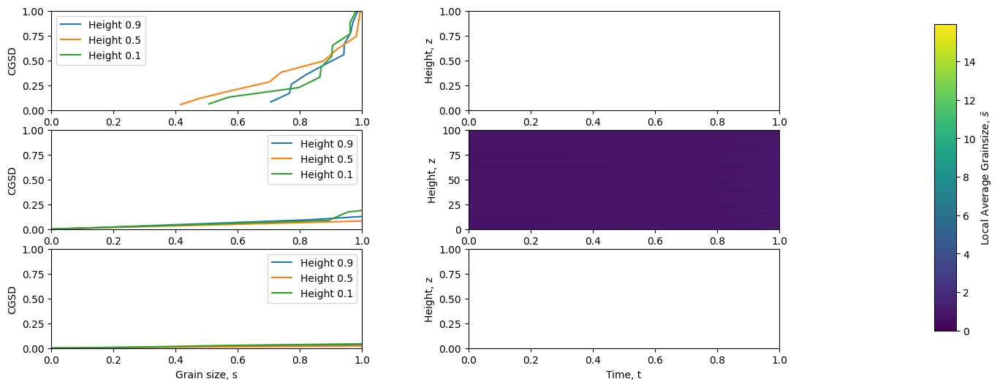

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import Normalize
from matplotlib.colorbar import ColorbarBase

class PolydisperseSegregationModel3:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
        ks = 1  # Constant segregation rate
        gamma_dot = 1  # Constant shear rate

        for i in range(self.column_height):
            local_average_size = np.mean(self.column[i, :])  # Average grainsize at height i

            for j in range(self.num_cells_m):
                s = self.column[i, j]  # Grainsize of the cell
                segregative_velocity = ks * gamma_dot * (s - local_average_size)
                updated_s = s + segregative_velocity * self.time_step
                self.column[i, j] = max(updated_s, 0)  # Prevent negative grain sizes

    def calculate_local_average_grainsize(self):
        # Calculate the local average grainsize over the nearest two neighbours in the m-direction
        local_avg_grainsize = np.zeros_like(self.column)
        # Apply periodic boundary conditions in the m-direction
        extended_column = np.column_stack((self.column[:, -1], self.column, self.column[:, 0]))
        for i in range(self.column_height):
            for j in range(1, self.num_cells_m + 1):  # Adjusted indices for the extended column
                local_avg_grainsize[i, j - 1] = (extended_column[i, j - 1] + extended_column[i, j + 1]) / 2
        return local_avg_grainsize

    def plot_results(self):
      fig, axs = plt.subplots(3, 3, figsize=(15, 6), gridspec_kw={'width_ratios': [1, 1, 0.05]})
      fig.subplots_adjust(wspace=0.5)

      # Determine the local average grainsize and its normalized values for color mapping
      local_avg_grainsize = self.calculate_local_average_grainsize()
      norm = Normalize(vmin=local_avg_grainsize.min(), vmax=local_avg_grainsize.max())

      # Iterate through the time snapshots to plot the graphs
      for i, time_idx in enumerate([0, len(self.history)//2, -1]):
          grainsize_distribution = np.sort(self.history[time_idx], axis=1)
          cumulative_distribution = np.cumsum(grainsize_distribution, axis=1)
          cumulative_distribution /= np.max(cumulative_distribution, axis=1)[:, np.newaxis]

          # Plot cumulative grainsize distribution for selected heights
          for height_fraction in [0.9, 0.5, 0.1]:
              height_index = int(height_fraction * self.column_height)
              axs[i, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
              axs[i, 0].legend()
              axs[i, 0].set_xlabel('Grain size, s')
              axs[i, 0].set_ylabel('CGSD')
              axs[i, 0].set_xlim([0, 1])
              axs[i, 0].set_ylim([0, 1])

          # Plot the heatmap of average grainsize over time
          if time_idx > 0:
              avg_grainsize_over_time = [np.mean(timestep, axis=1) for timestep in self.history[:time_idx + 1]]
              avg_grainsize_over_time = np.array(avg_grainsize_over_time).T  # Transpose to match the axes
              im = axs[i, 1].imshow(avg_grainsize_over_time, aspect='auto', origin='lower', cmap='viridis', norm=norm,
                                     extent=[0, self.history[time_idx].shape[0] * self.time_step, 0, self.column_height])
          axs[i, 1].set_xlabel('Time, t')
          axs[i, 1].set_ylabel('Height, z')

      # Remove empty subplots by clearing them
      for ax in axs[:, 2]:
          ax.remove()
      axs = np.delete(axs, 2, 1)  # Remove the third column from the array to prevent index errors

      # Create the color bar for the local average grainsize
      cbar_ax = fig.add_axes([0.93, 0.15, 0.02, 0.7])
      cbar = fig.colorbar(im, cax=cbar_ax)
      cbar.set_label('Local Average Grainsize, $\\bar{s}$')

      plt.show()


# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel3(column_height, num_cells_m, 1, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()

<ipython-input-29-ee4bb9a0ac8f>:31: RuntimeWarning: invalid value encountered in sqrt
  gamma_dot = np.sqrt(shear_factor)


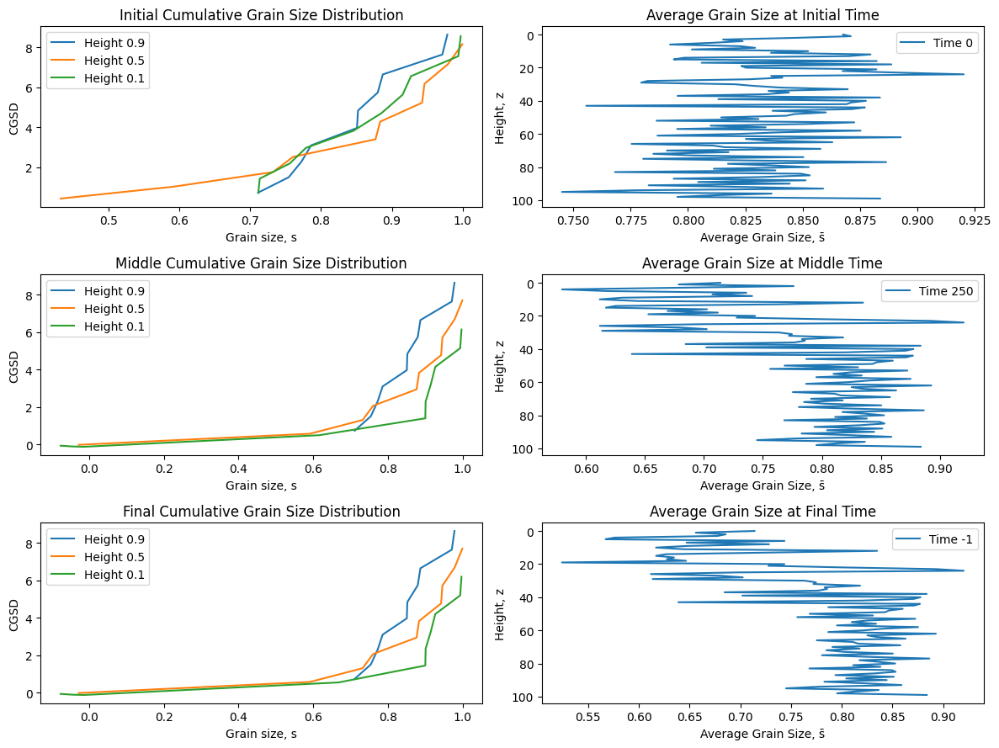

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

class PolydisperseSegregationModel:
    def __init__(self, column_height, num_cells_m, segregation_rate, alpha_i, time_step):
        self.column_height = column_height
        self.num_cells_m = num_cells_m
        self.segregation_rate = np.array(segregation_rate)
        self.alpha_i = alpha_i
        self.time_step = time_step
        self.column = self.initialize_column()
        self.history = []

    def initialize_column(self):
        F = np.random.rand(self.column_height, self.num_cells_m)
        s = F**(1 / (3 - self.alpha_i))
        return s

    def run_simulation(self, total_time):
        for _ in np.arange(0, total_time, self.time_step):
            self.segregate()
            self.history.append(self.column.copy())

    def segregate(self):
      for i in range(self.column_height):
        for j in range(self.num_cells_m):
            z = i / self.column_height
            s = self.column[i, j]
            # Ensure that (1 - z) / s is always non-negative
            shear_factor = (1 - z) / s if s <= (1 - z) else 0
            gamma_dot = np.sqrt(shear_factor)
            local_average_size = np.mean(self.column[i, :])
            segregative_velocity = self.segregation_rate[i] * gamma_dot * (s - local_average_size)
            # Check for NaN values and avoid updating if encountered
            if not np.isnan(segregative_velocity):
                self.column[i, j] += segregative_velocity * self.time_step

    def plot_results(self):
    # Function to plot the final graphs similar to Figure 14 in the paper

    # Plot the cumulative grainsize distributions at different heights
      fig, axs = plt.subplots(3, 2, figsize=(12, 9))  # This creates a 3x2 grid of subplots
      time_snapshots = [0, len(self.history)//2, -1]  # Three time points: start, middle, and end

      for idx, time_point in enumerate(time_snapshots):
          # For the left column: Initial, Middle, and Final cumulative grainsize distributions
          grainsize_distribution = np.sort(self.history[time_point], axis=1)
          cumulative_distribution = np.cumsum(grainsize_distribution, axis=1) / grainsize_distribution[:, -1][:, np.newaxis]

          for height_fraction in [0.9, 0.5, 0.1]:
              height_index = int(height_fraction * self.column_height)
              axs[idx, 0].plot(grainsize_distribution[height_index], cumulative_distribution[height_index], label=f'Height {height_fraction}')
              axs[idx, 0].legend()

          axs[idx, 0].set_xlabel('Grain size, s')
          axs[idx, 0].set_ylabel('CGSD')

          # For the right column: Average grainsize over height at three time snapshots
          average_grainsize = np.mean(self.history[time_point], axis=1)
          axs[idx, 1].plot(average_grainsize, np.arange(self.column_height), label=f'Time {time_point}')
          axs[idx, 1].invert_yaxis()  # Invert y-axis to have 0 at the bottom
          axs[idx, 1].legend()

          axs[idx, 1].set_xlabel('Average Grain Size, s̄')
          axs[idx, 1].set_ylabel('Height, z')

      axs[0, 0].set_title("Initial Cumulative Grain Size Distribution")
      axs[0, 1].set_title(f'Average Grain Size at Initial Time')
      axs[1, 0].set_title("Middle Cumulative Grain Size Distribution")
      axs[1, 1].set_title(f'Average Grain Size at Middle Time')
      axs[2, 0].set_title("Final Cumulative Grain Size Distribution")
      axs[2, 1].set_title(f'Average Grain Size at Final Time')

      plt.tight_layout()
      plt.show()



# Define parameters based on the paper's descriptions
column_height = 100  # Number of vertical cells
num_cells_m = 10     # Number of cells in m-direction for polydispersity
alpha_i = -2         # Initial power law gradient
time_step = 0.01     # Simulation time step
total_time = 5       # Total simulation time
segregation_rate = [np.sqrt(1 - i / column_height) for i in range(column_height)]  # Segregation rate array

# Initialize and run the simulation
model = PolydisperseSegregationModel(column_height, num_cells_m, segregation_rate, alpha_i, time_step)
model.run_simulation(total_time)

# Plot the results as in the paper's figure
model.plot_results()